https://mset.space - платформа для проведения анализа данных, построения моделей и внедрения моделей в продукцию.


https://mset.space - platform for data analysis, model building and implementation into production.


Ноутбуки для платформы mset.space
https://github.com/MindSetLib/MS-Education

Low code ML - библиотека машинного обучения
https://github.com/MindSetLib/Insolver


Телеграм канал платформы
https://t.me/msetspace

Связь с разработчиками:
telegram: @frankshikhaliev
email: request@mind-set.ru

![](https://pycaret.org/wp-content/uploads/2020/10/pycaret2.2.png)

03.12.2020

PyCaret – это оболочка Python над библиотеками машинного обучения, которая позволяет всего в несколько строк кода использовать модели из библиотек: scikit-learn, XGBoost, Microsoft LightGBM, spaCy и многими другими.

Установим библиотеку

In [ ]:
!pip install pycaret -q

     |████████████████████████████████| 256kB 12.3MB/s eta 0:00:01
     |████████████████████████████████| 174kB 21.6MB/s 
     |████████████████████████████████| 66.3MB 54kB/s 
     |████████████████████████████████| 1.6MB 50.2MB/s 
     |████████████████████████████████| 1.8MB 37.3MB/s 
     |████████████████████████████████| 266kB 44.0MB/s 
     |████████████████████████████████| 13.9MB 39.8MB/s 
     |████████████████████████████████| 6.8MB 46.4MB/s 
     |████████████████████████████████| 102kB 11.4MB/s 
     |████████████████████████████████| 276kB 44.7MB/s 
     |████████████████████████████████| 148.9MB 74kB/s 
     |████████████████████████████████| 3.1MB 42.6MB/s 
     |████████████████████████████████| 71kB 8.6MB/s 
     |████████████████████████████████| 71kB 9.1MB/s 
     |████████████████████████████████| 604kB 52.3MB/s 
     |████████████████████████████████| 1.1MB 46.3MB/s 
     |████████████████████████████████| 337kB 48.2MB/s 
     |████████████████████████████████| 8

Импортируем модуль для получения данных

In [ ]:
from pycaret.datasets import get_data # загрузить данные

# отображать интерактивную визуализацию
from pycaret.utils import enable_colab
enable_colab()

Colab mode enabled.


### Классификация

`pycaret.classification` [модуль](https://pycaret.readthedocs.io/en/latest/api/classification.html) для бинарной и мульти классификации, который содержит 18 различных моделей и 14 визуализаций.

В данном блоке мы научимся:

* Загружать датасет из библиотеки Pycaret

* Создавать модель классификации

* Автоматически оптимизировать гиперпараметры

* Строить графики

* Делать предсказания

* Сохранять и загружать модель

**Загрузим данные**

Мы будем использовать набор данных [Default of Credit Card Clients Dataset](https://archive.ics.uci.edu/ml/datasets/default+of+credit+card+clients). Этот набор данных содержит информацию о платежах, демографических факторах, кредитных данных, истории платежей и выписках по счетам клиентов кредитных карт в Тайване с апреля 2005 г. по сентябрь 2005 г. Имеется 24 000 наблюдений и 25 фич.

- **ID:** ID of each client
- **LIMIT_BAL:** Amount of given credit in NT dollars (includes individual and family/supplementary credit)
- **SEX:** Gender (1=male, 2=female)
- **EDUCATION:** (1=graduate school, 2=university, 3=high school, 4=others, 5=unknown, 6=unknown)
- **MARRIAGE:** Marital status (1=married, 2=single, 3=others)
- **AGE:** Age in years
- **PAY_0 to PAY_6:** Repayment status by n months ago (PAY_0 = last month ... PAY_6 = 6 months ago) (Labels: -1=pay duly, 1=payment delay for one month, 2=payment delay for two months, ... 8=payment delay for eight months, 9=payment delay for nine months and above)
- **BILL_AMT1 to BILL_AMT6:** Amount of bill statement by n months ago ( BILL_AMT1 = last_month .. BILL_AMT6 = 6 months ago)
- **PAY_AMT1 to PAY_AMT6:** Amount of payment by n months ago ( BILL_AMT1 = last_month .. BILL_AMT6 = 6 months ago)
- **default:** Default payment (1=yes, 0=no) `Target Column`

Полный перечень доступных датасетов можно посмотреть [здесь](https://pycaret.org/get-data/).

In [ ]:
dataset = get_data('credit')

,LIMIT_BAL,SEX,EDUCATION,MARRIAGE,AGE,PAY_1,PAY_2,PAY_3,PAY_4,PAY_5,PAY_6,BILL_AMT1,BILL_AMT2,BILL_AMT3,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,default
0,20000,2,2,1,24,2,2,-1,-1,-2,-2,3913.0,3102.0,689.0,0.0,0.0,0.0,0.0,689.0,0.0,0.0,0.0,0.0,1
1,90000,2,2,2,34,0,0,0,0,0,0,29239.0,14027.0,13559.0,14331.0,14948.0,15549.0,1518.0,1500.0,1000.0,1000.0,1000.0,5000.0,0
2,50000,2,2,1,37,0,0,0,0,0,0,46990.0,48233.0,49291.0,28314.0,28959.0,29547.0,2000.0,2019.0,1200.0,1100.0,1069.0,1000.0,0
3,50000,1,2,1,57,-1,0,-1,0,0,0,8617.0,5670.0,35835.0,20940.0,19146.0,19131.0,2000.0,36681.0,10000.0,9000.0,689.0,679.0,0
4,50000,1,1,2,37,0,0,0,0,0,0,64400.0,57069.0,57608.0,19394.0,19619.0,20024.0,2500.0,1815.0,657.0,1000.0,1000.0,800.0,0


Если мы хотим получить отчёт о датасете, тогда необходимо передать параметр `profile=True`

In [ ]:
dataset = get_data('credit', profile = True)

Проанализировав данный отчёт, мы можем сделать некоторые выводы:

* **Пропущенные значения:** в наших данных нет пропущенных значений, но когда модель будет строить предсказания для вновь поступивших данных, пропущенные значения могут быть. По дефолту, при инициализации `setup` модель будет заполнять числовые пропущенные значения средним значением, а категориальные константой. Используя `numeric_imputation` и `categorical_imputation` параметры в setup мы можем указать какими значениями необходимо заполнять пропуски.

* **Мультиколлинеарность:** есть высокая корреляция между BILL_AMT1 ... BIL_AMT6. Можно удалить [мультиколллинеарность](https://univer-nn.ru/ekonometrika/multikollinearnost/) используя параметры `remove_multicollinearity` и `multicollinearity_threshold` в `setup`.

* **Дисперсия данных:** обратим внимание на то, насколько различается диапазон значений у разных числовых фич. Например, `AGE` от 21 до 79, а `BILL_AMT1` от -165,580 до 964,511. Это может быть проблемой для моделей, которые предполагают, что дисперсия у фич имеет один и тот же порядок. Мы можем нормировать данные используя параметр `normalize` в `setup`.

* **Распределение фич:** некоторые числовые фичи имеют распределение отличное от нормального. Это может стать проблемой для Logistic Regression, Linear Discriminant Analysis (LDA) и Naive Bayes, которые предполагают, что данные имеют нормальное или приблизительно нормальное распределение. Можно использовать параметр `transformation` в `setup`, чтобы привести данные к нормальному распределению.

* **Групировка фич:** из описания датасета мы знаем, что некоторые фичи связаны друг с другом, такие как `BILL_AMT1` ... `BILL_AMT6` и `PAY_AMT1` ... `PAY_AMT6`. Можно использовать параметр `group_features` в `setup`, чтобы извлечь статистическую информацию из этих фич.

**Разделим данные**

In [ ]:
# frac=0.95: отберем 95% данных на df_train
# random_state=786: зафиксируем случайность, каждый раз будем получать одно и тоже множество
df_train = dataset.sample(frac=0.95, random_state=786)
df_train

,LIMIT_BAL,SEX,EDUCATION,MARRIAGE,AGE,PAY_1,PAY_2,PAY_3,PAY_4,PAY_5,PAY_6,BILL_AMT1,BILL_AMT2,BILL_AMT3,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,default
20534,270000,2,1,2,34,0,0,2,0,0,0,67544.0,54523.0,18865.0,44908.0,19508.0,15860.0,4025.0,5.0,34000.0,0.0,0.0,0.0,0
6885,160000,2,1,2,42,-2,-2,-2,-2,-2,-2,0.0,0.0,0.0,0.0,741.0,0.0,0.0,0.0,0.0,741.0,0.0,0.0,0
1553,360000,2,1,2,30,0,0,0,0,0,0,139762.0,143515.0,147037.0,146117.0,145884.0,147645.0,6000.0,6000.0,4818.0,5000.0,5000.0,4500.0,0
1952,20000,2,1,2,25,0,0,0,0,0,0,17776.0,18886.0,19551.0,18964.0,19676.0,20116.0,1700.0,1300.0,662.0,1000.0,747.0,602.0,0
21422,70000,1,2,2,29,0,0,0,0,0,0,53700.0,53938.0,47852.0,48538.0,49034.0,49689.0,2200.0,8808.0,2200.0,2000.0,2000.0,2300.0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4516,130000,1,3,2,45,0,0,-1,0,-1,-1,13513.0,11800.0,2522.0,1261.0,390.0,390.0,1000.0,2522.0,0.0,390.0,390.0,390.0,0
8641,290000,2,1,2,29,0,0,0,0,-1,0,41435.0,30229.0,9020.0,-77.0,8123.0,210989.0,1690.0,3000.0,0.0,8200.0,205000.0,6000.0,0
6206,210000,1,2,1,41,1,2,0,0,0,0,149343.0,145319.0,86335.0,69670.0,59502.0,119494.0,0.0,5000.0,3600.0,2000.0,2000.0,5000.0,0
2110,550000,1,2,1,47,0,0,0,0,0,-2,68328.0,76797.0,55200.0,30000.0,0.0,0.0,10000.0,20000.0,5000.0,0.0,0.0,0.0,0


In [ ]:
# dataset.drop: удалим из датасета наблюдения, которые отобрали для тренировки модели
# df_train.index: укажем индексы наблюдений, которые необходимо удалить
df_test = dataset.drop(df_train.index)
df_test

,LIMIT_BAL,SEX,EDUCATION,MARRIAGE,AGE,PAY_1,PAY_2,PAY_3,PAY_4,PAY_5,PAY_6,BILL_AMT1,BILL_AMT2,BILL_AMT3,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,default
5,100000,2,2,2,23,0,-1,-1,0,0,-1,11876.0,380.0,601.0,221.0,-159.0,567.0,380.0,601.0,0.0,581.0,1687.0,1542.0,0
39,380000,1,2,2,32,-1,-1,-1,-1,-1,-1,22401.0,21540.0,15134.0,32018.0,11849.0,11873.0,21540.0,15138.0,24677.0,11851.0,11875.0,8251.0,0
57,200000,2,2,1,32,-1,-1,-1,-1,2,-1,9076.0,5787.0,-684.0,5247.0,3848.0,3151.0,5818.0,15.0,9102.0,17.0,3165.0,1395.0,0
72,200000,1,1,1,53,2,2,2,2,2,2,138180.0,140774.0,142460.0,144098.0,147124.0,149531.0,6300.0,5500.0,5500.0,5500.0,5000.0,5000.0,1
103,240000,1,1,2,41,1,-1,-1,0,0,-1,95.0,2622.0,3301.0,3164.0,360.0,1737.0,2622.0,3301.0,0.0,360.0,1737.0,924.0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
23978,50000,1,2,1,37,1,2,2,2,0,0,10904.0,9316.0,4328.0,2846.0,1585.0,1324.0,0.0,3000.0,0.0,0.0,1000.0,1000.0,1
23979,220000,1,2,1,41,0,0,-1,-1,-2,-2,45075.0,8840.0,1369.0,5924.0,1759.0,1824.0,8840.0,6643.0,5924.0,1759.0,1824.0,7022.0,0
23981,420000,1,1,2,34,0,0,0,0,0,0,131939.0,136721.0,140011.0,141695.0,144839.0,147954.0,7000.0,7000.0,5500.0,5500.0,5600.0,5000.0,0
23985,90000,1,2,1,36,0,0,0,0,0,0,7752.0,9112.0,10306.0,11328.0,12036.0,14329.0,1500.0,1500.0,1500.0,1200.0,2500.0,0.0,1


In [ ]:
# reset_index: переопределим нумерацию индексов, с 0 до n
# inplace=True: сохранить изменения 
# drop=True: удалить старые индексы и поставить новые с 0 до n, иначе старые индексы сохранятся в отдельном столбце
df_train.reset_index(inplace=True, drop=True)
df_test.reset_index(inplace=True, drop=True)
df_train

,LIMIT_BAL,SEX,EDUCATION,MARRIAGE,AGE,PAY_1,PAY_2,PAY_3,PAY_4,PAY_5,PAY_6,BILL_AMT1,BILL_AMT2,BILL_AMT3,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,default
0,270000,2,1,2,34,0,0,2,0,0,0,67544.0,54523.0,18865.0,44908.0,19508.0,15860.0,4025.0,5.0,34000.0,0.0,0.0,0.0,0
1,160000,2,1,2,42,-2,-2,-2,-2,-2,-2,0.0,0.0,0.0,0.0,741.0,0.0,0.0,0.0,0.0,741.0,0.0,0.0,0
2,360000,2,1,2,30,0,0,0,0,0,0,139762.0,143515.0,147037.0,146117.0,145884.0,147645.0,6000.0,6000.0,4818.0,5000.0,5000.0,4500.0,0
3,20000,2,1,2,25,0,0,0,0,0,0,17776.0,18886.0,19551.0,18964.0,19676.0,20116.0,1700.0,1300.0,662.0,1000.0,747.0,602.0,0
4,70000,1,2,2,29,0,0,0,0,0,0,53700.0,53938.0,47852.0,48538.0,49034.0,49689.0,2200.0,8808.0,2200.0,2000.0,2000.0,2300.0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
22795,130000,1,3,2,45,0,0,-1,0,-1,-1,13513.0,11800.0,2522.0,1261.0,390.0,390.0,1000.0,2522.0,0.0,390.0,390.0,390.0,0
22796,290000,2,1,2,29,0,0,0,0,-1,0,41435.0,30229.0,9020.0,-77.0,8123.0,210989.0,1690.0,3000.0,0.0,8200.0,205000.0,6000.0,0
22797,210000,1,2,1,41,1,2,0,0,0,0,149343.0,145319.0,86335.0,69670.0,59502.0,119494.0,0.0,5000.0,3600.0,2000.0,2000.0,5000.0,0
22798,550000,1,2,1,47,0,0,0,0,0,-2,68328.0,76797.0,55200.0,30000.0,0.0,0.0,10000.0,20000.0,5000.0,0.0,0.0,0.0,0


### Инициализация модели

Импортируем все [методы](https://pycaret.readthedocs.io/en/latest/api/classification.html) из модуля `pycaret.classification`

In [ ]:
from pycaret.classification import *

При инициализации `setup`, тип задачи (бинарная классификация или мультиклассификация) будет определен автоматически, исходя из столбца указанного в параметре `target`.



Все параметры `setup` [здесь](https://pycaret.org/classification/).

In [ ]:
# setup: инициализирует окружение для моделей

cls = setup(data = df_train,                                                                 
            target = 'default',                                                              
            # session_id: зафиксируем случайность (подобно random_state в scikit-learn)
            session_id = 123,
            # нормируем данные
            normalize = True,
            # привести данные к нормальному распределению
            transformation = True,
            # удалить категориальные фичи у которых невысокая дисперсия
            ignore_low_variance = True,
            # remove_multicollinearity: избавится от мультиколлениарности
            # multicollinearity_threshold: указать порог при котором избавляемся от мультиколлинеарности
            remove_multicollinearity = True, multicollinearity_threshold = 0.9,
            # отобрать только важные фичи, не важные не использовать
            feature_selection = True,
            # указать алгоритм отбора важных фич
            feature_selection_method = 'boruta',
            # преобразует числовые произнаки в категориальные
            # используя правило Стёрджеса определяет оптимальное кол-во интервалов и кластеризует данные методом KMeans
            bin_numeric_features = ['LIMIT_BAL', 'AGE'],
            # сгрупируем признаки
            group_features = [['BILL_AMT1', 'BILL_AMT2','BILL_AMT3', 'BILL_AMT4', 'BILL_AMT5', 'BILL_AMT6'], \
                              ['PAY_AMT1','PAY_AMT2', 'PAY_AMT3', 'PAY_AMT4', 'PAY_AMT5', 'PAY_AMT6']],
            # укажем наименование эксперимента
            experiment_name = 'credit1')                                             

,Description,Value
0,session_id,123
1,Target,default
2,Target Type,Binary
3,Label Encoded,"0: 0, 1: 1"
4,Original Data,"(22800, 24)"
5,Missing Values,False
6,Numeric Features,14
7,Categorical Features,9
8,Ordinal Features,False
9,High Cardinality Features,False


После того как мы инициализировали настройки, можно посмотреть какие модели можно использовать.

In [ ]:
models()

,Name,Reference,Turbo
ID,,,
lr,Logistic Regression,sklearn.linear_model._logistic.LogisticRegression,True
knn,K Neighbors Classifier,sklearn.neighbors._classification.KNeighborsCl...,True
nb,Naive Bayes,sklearn.naive_bayes.GaussianNB,True
dt,Decision Tree Classifier,sklearn.tree._classes.DecisionTreeClassifier,True
svm,SVM - Linear Kernel,sklearn.linear_model._stochastic_gradient.SGDC...,True
rbfsvm,SVM - Radial Kernel,sklearn.svm._classes.SVC,False
gpc,Gaussian Process Classifier,sklearn.gaussian_process._gpc.GaussianProcessC...,False
mlp,MLP Classifier,pycaret.internal.tunable.TunableMLPClassifier,False
ridge,Ridge Classifier,sklearn.linear_model._ridge.RidgeClassifier,True


**Сравним модели и получим лучшую**

Сейчас будет натренировано 15 моделей, используя крос валидацию 10 частей, оценены по метрикам используемым для задач классификации. По умолчанию сортируется и отбирается лучшая модель по метрике `accuracy`. Все модели тренируются по дефолтным настройкам.

Обратим внимание, что в output будет отображатся информация интерактивно для этого мы при импорте писали следующий код:

`from pycaret.utils import enable_colab`

`enable_colab()`

In [ ]:
best_model = compare_models()

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,TT (Sec)
ridge,Ridge Classifier,0.8254,0.0000,0.3597,0.6943,0.4736,0.3814,0.4112,0.067
gbc,Gradient Boosting Classifier,0.8247,0.7772,0.3580,0.6911,0.4715,0.3789,0.4085,6.641
lda,Linear Discriminant Analysis,0.8244,0.7741,0.3769,0.6763,0.4839,0.3883,0.4125,0.367
ada,Ada Boost Classifier,0.8231,0.7728,0.3437,0.6925,0.4591,0.3674,0.3998,1.666
catboost,CatBoost Classifier,0.8217,0.7739,0.3623,0.6708,0.4702,0.3744,0.4002,13.381
lightgbm,Light Gradient Boosting Machine,0.8215,0.7708,0.3609,0.6722,0.4690,0.3733,0.3997,0.443
rf,Random Forest Classifier,0.8196,0.7583,0.3580,0.6617,0.4644,0.3674,0.3926,3.028
et,Extra Trees Classifier,0.8157,0.7492,0.3683,0.6354,0.4661,0.3642,0.3841,2.272
xgboost,Extreme Gradient Boosting,0.8153,0.7567,0.3591,0.6379,0.4593,0.3584,0.3800,6.537
lr,Logistic Regression,0.7880,0.6968,0.1109,0.5894,0.1829,0.1232,0.1812,0.511


Посмотрим на лучшую модель

In [ ]:
print(best_model)

RidgeClassifier(alpha=1.0, class_weight=None, copy_X=True, fit_intercept=True,
                max_iter=None, normalize=False, random_state=123, solver='auto',
                tol=0.001)


Можно отобрать n лучших моделей.

In [ ]:
top3 = compare_models(n_select = 3)

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,TT (Sec)
ridge,Ridge Classifier,0.8254,0.0000,0.3597,0.6943,0.4736,0.3814,0.4112,0.070
gbc,Gradient Boosting Classifier,0.8247,0.7772,0.3580,0.6911,0.4715,0.3789,0.4085,6.994
lda,Linear Discriminant Analysis,0.8244,0.7741,0.3769,0.6763,0.4839,0.3883,0.4125,0.388
ada,Ada Boost Classifier,0.8231,0.7728,0.3437,0.6925,0.4591,0.3674,0.3998,1.765
catboost,CatBoost Classifier,0.8217,0.7739,0.3623,0.6708,0.4702,0.3744,0.4002,14.864
lightgbm,Light Gradient Boosting Machine,0.8215,0.7708,0.3609,0.6722,0.4690,0.3733,0.3997,0.474
rf,Random Forest Classifier,0.8196,0.7583,0.3580,0.6617,0.4644,0.3674,0.3926,3.224
et,Extra Trees Classifier,0.8157,0.7492,0.3683,0.6354,0.4661,0.3642,0.3841,2.428
xgboost,Extreme Gradient Boosting,0.8153,0.7567,0.3591,0.6379,0.4593,0.3584,0.3800,6.983
lr,Logistic Regression,0.7880,0.6968,0.1109,0.5894,0.1829,0.1232,0.1812,0.528


In [ ]:
top3

[RidgeClassifier(alpha=1.0, class_weight=None, copy_X=True, fit_intercept=True,
                 max_iter=None, normalize=False, random_state=123, solver='auto',
                 tol=0.001),
 GradientBoostingClassifier(ccp_alpha=0.0, criterion='friedman_mse', init=None,
                            learning_rate=0.1, loss='deviance', max_depth=3,
                            max_features=None, max_leaf_nodes=None,
                            min_impurity_decrease=0.0, min_impurity_split=None,
                            min_samples_leaf=1, min_samples_split=2,
                            min_weight_fraction_leaf=0.0, n_estimators=100,
                            n_iter_no_change=None, presort='deprecated',
                            random_state=123, subsample=1.0, tol=0.0001,
                            validation_fraction=0.1, verbose=0,
                            warm_start=False),
 LinearDiscriminantAnalysis(n_components=None, priors=None, shrinkage=None,
                          

По ID мы можем инициализировать любую модель. Давайте инициализируем LightGBM. При инициализации мы увидим таблицу с метрикой при крос валидации на каждую часть.

In [ ]:
lightgbm = create_model('lightgbm', cross_validation = True)

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.8133,0.7700,0.3352,0.6393,0.4398,0.3407,0.3663
1,0.8277,0.7731,0.3954,0.6832,0.5009,0.4056,0.4278
2,0.8233,0.7742,0.3410,0.6959,0.4577,0.3666,0.4000
3,0.8214,0.7816,0.3696,0.6649,0.4751,0.3779,0.4016
4,0.8221,0.7844,0.3467,0.6836,0.4601,0.3669,0.3973
5,0.8321,0.7826,0.3926,0.7098,0.5055,0.4143,0.4407
6,0.8139,0.7733,0.3496,0.6354,0.4510,0.3502,0.3728
7,0.8264,0.7616,0.3352,0.7222,0.4579,0.3707,0.4095
8,0.8195,0.7596,0.3582,0.6614,0.4647,0.3675,0.3925
9,0.8157,0.7476,0.3851,0.6262,0.4769,0.3726,0.3889


Можем указать на сколько частей разделить данные для крос валидации.

In [ ]:
lightgbm = create_model('lightgbm', fold = 3)

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.8190,0.7665,0.3534,0.6608,0.4605,0.3635,0.3893
1,0.8220,0.7746,0.3792,0.6622,0.4822,0.3842,0.4060
2,0.8143,0.7523,0.3465,0.6387,0.4493,0.3492,0.3728
Mean,0.8184,0.7645,0.3597,0.6539,0.4640,0.3656,0.3894
SD,0.0032,0.0092,0.0141,0.0108,0.0137,0.0144,0.0135


**Тюнинг модели**

После того, как мы отобрали лучшую модель, мы можем автоматически подобрать лучшие гиперпараметры. Для этого необходимо использовать метод `tune_model`.

По дефолту используется метод случайного поиска гиперпараметров и оптимизация происходит по accuracy. Чтобы изменить метрику по которой оптимизируем гиперпараметры, нам необходимо в метод `tune_model` передать атрибут `optimize = 'AUC'` с названием метрики по которой хотели бы провести оптимизацию.

In [ ]:
tuned_lightgbm = tune_model(lightgbm, optimize = 'AUC')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.8102,0.7846,0.3238,0.6278,0.4272,0.3271,0.3529
1,0.8271,0.7888,0.3782,0.6911,0.4889,0.3954,0.4214
2,0.8208,0.7813,0.3381,0.6821,0.4521,0.3592,0.3909
3,0.8214,0.7829,0.3639,0.6684,0.4712,0.3749,0.4000
4,0.8164,0.7972,0.3438,0.6522,0.4503,0.3525,0.3786
5,0.8308,0.7929,0.3954,0.7005,0.5055,0.4128,0.4374
6,0.8202,0.7802,0.3696,0.6582,0.4734,0.3751,0.3978
7,0.8283,0.7636,0.3610,0.7119,0.4791,0.3892,0.4214
8,0.8164,0.7636,0.3582,0.6443,0.4604,0.3605,0.3831
9,0.8176,0.7670,0.3678,0.6432,0.4680,0.3676,0.3885


Посмотрим и сравним метрики, если мы будем оптимизировать по 'Accuracy'.

In [ ]:
tuned_lightgbm = tune_model(lightgbm, optimize = 'Accuracy')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.8170,0.7811,0.2923,0.6939,0.4113,0.3236,0.3662
1,0.8252,0.7837,0.3095,0.7397,0.4364,0.3529,0.4000
2,0.8233,0.7762,0.2751,0.7680,0.4051,0.3275,0.3874
3,0.8271,0.7818,0.3095,0.7552,0.4390,0.3573,0.4072
4,0.8183,0.7871,0.2923,0.7034,0.4130,0.3265,0.3707
5,0.8271,0.7784,0.3238,0.7386,0.4502,0.3656,0.4096
6,0.8164,0.7781,0.2894,0.6918,0.4081,0.3204,0.3632
7,0.8246,0.7578,0.2837,0.7674,0.4142,0.3358,0.3937
8,0.8177,0.7565,0.2894,0.7014,0.4097,0.3233,0.3678
9,0.8207,0.7653,0.2960,0.7153,0.4187,0.3336,0.3792


Можно модели тренировать на GPU.

In [ ]:
xgboost = create_model('xgboost', tree_method = 'gpu_hist')

tuned_xgboost = tune_model(xgboost)

Есть простой способ деплоя моделей на: Microsoft Azure и Google Cloud Platform. [Подробнее](https://towardsdatascience.com/pycaret-2-1-is-here-whats-new-4aae6a7f636a).

In [ ]:
import os
os.environ['AZURE_STORAGE_CONNECTION_STRING'] = 'your-conn-string'

from pycaret.classification import deploy_model
deploy_model(model = model, model_name = 'model-name', platform = 'azure', authentication = {'container' : 'container-name'})

### Ансамбли

В данной библиотеке реализованы 4 техники:

* Бэггинг

* Бустинг

* Блендинг

* Стекинг

**Бэггинг**

С помощью бутстрапированной выборки (выборка с возвращением, производится по признакам или по наблюдениям) строится n моделей, после чего в случае регресии их ответы усредняются, в случае классификации проходит голосование. Модели тренируются независимо.

In [ ]:
dt = create_model('dt')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.7287,0.6140,0.4069,0.3859,0.3961,0.2213,0.2214
1,0.7287,0.6075,0.3897,0.3820,0.3858,0.2117,0.2117
2,0.7444,0.6246,0.4097,0.4145,0.4121,0.2488,0.2488
3,0.7331,0.6152,0.4011,0.3922,0.3966,0.2253,0.2253
4,0.7444,0.6417,0.4527,0.4213,0.4365,0.2714,0.2717
5,0.7268,0.6008,0.3782,0.3761,0.3771,0.2022,0.2022
6,0.7243,0.6163,0.4269,0.3830,0.4038,0.2252,0.2257
7,0.7274,0.6016,0.3782,0.3771,0.3777,0.2032,0.2032
8,0.7105,0.5953,0.3897,0.3532,0.3706,0.1832,0.1836
9,0.7323,0.6167,0.4138,0.3924,0.4028,0.2304,0.2306


In [ ]:
bagged_dt = ensemble_model(dt)

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.8070,0.7204,0.3209,0.6120,0.4211,0.3185,0.3425
1,0.8195,0.7298,0.3811,0.6488,0.4801,0.3798,0.3995
2,0.8083,0.7180,0.3066,0.6257,0.4115,0.3127,0.3411
3,0.8083,0.7388,0.3467,0.6080,0.4416,0.3362,0.3555
4,0.8139,0.7193,0.3295,0.6461,0.4364,0.3388,0.3663
5,0.8114,0.7377,0.3438,0.6250,0.4436,0.3414,0.3635
6,0.7982,0.7315,0.3095,0.5714,0.4015,0.2928,0.3128
7,0.8045,0.7311,0.3009,0.6069,0.4023,0.3010,0.3275
8,0.8083,0.7168,0.3095,0.6243,0.4138,0.3144,0.3421
9,0.8157,0.7338,0.3563,0.6392,0.4576,0.3572,0.3793


Посмотрим параметры моделей

In [ ]:
print(bagged_dt)

BaggingClassifier(base_estimator=DecisionTreeClassifier(ccp_alpha=0.0,
                                                        class_weight=None,
                                                        criterion='gini',
                                                        max_depth=None,
                                                        max_features=None,
                                                        max_leaf_nodes=None,
                                                        min_impurity_decrease=0.0,
                                                        min_impurity_split=None,
                                                        min_samples_leaf=1,
                                                        min_samples_split=2,
                                                        min_weight_fraction_leaf=0.0,
                                                        presort='deprecated',
                                                        random_state=123,
 

**Бустинг**

Ансамбль будет строится последовательно, где каждая следующая модель будет корректировать ошибки уже построенных моделей.

In [ ]:
boosted_dt = ensemble_model(dt, method = 'Boosting')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.7663,0.6980,0.3496,0.4552,0.3955,0.2537,0.2571
1,0.7531,0.6834,0.3582,0.4237,0.3882,0.2349,0.2362
2,0.7895,0.7286,0.3381,0.5291,0.4126,0.2918,0.3027
3,0.7794,0.6756,0.2779,0.4924,0.3553,0.2345,0.2485
4,0.7732,0.6816,0.3381,0.4739,0.3946,0.2599,0.2655
5,0.7832,0.7307,0.3897,0.5056,0.4401,0.3085,0.3125
6,0.7920,0.7009,0.3438,0.5381,0.4196,0.3003,0.3115
7,0.7813,0.6648,0.2923,0.5000,0.3689,0.2475,0.2606
8,0.7669,0.6584,0.3209,0.4534,0.3758,0.2377,0.2430
9,0.7818,0.6919,0.3592,0.5000,0.4181,0.2882,0.2942


**Блендинг**

Используются предсказания из различных архитектур моделей.

In [ ]:
# инициализируем модели
lightgbm = create_model('lightgbm', verbose = False)
dt = create_model('dt', verbose = False)
lr = create_model('lr', verbose = False)

In [ ]:
# soft использует предсказанные вероятности для голосования, а hard - предсказанные лейблы
blend_soft = blend_models(estimator_list = [lightgbm, dt, lr], method = 'soft')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.7776,0.7389,0.3668,0.4885,0.4190,0.2849,0.2894
1,0.7701,0.7308,0.3668,0.4672,0.4109,0.2706,0.2737
2,0.7882,0.7543,0.3496,0.5236,0.4192,0.2960,0.3050
3,0.7688,0.7565,0.3754,0.4645,0.4152,0.2731,0.2756
4,0.7914,0.7773,0.4183,0.5290,0.4672,0.3397,0.3433
5,0.7870,0.7463,0.3009,0.5224,0.3818,0.2642,0.2789
6,0.7732,0.7317,0.4011,0.4778,0.4361,0.2955,0.2973
7,0.7970,0.7333,0.3066,0.5661,0.3978,0.2884,0.3081
8,0.7914,0.7169,0.3324,0.5370,0.4106,0.2923,0.3047
9,0.7937,0.7309,0.3477,0.5426,0.4238,0.3055,0.3167


Можно передать отобранные нами лучшие модели top3.

In [ ]:
blender_top3 = blend_models(top3)

**Стэкинг**

Мета-модель использует предсказания натренированных моделей в качестве входа.

In [ ]:
stack_soft = stack_models(top3)

Можем указать, какую модель берем в качестве мета-модели.

In [ ]:
xgboost = create_model('xgboost')
stack_soft2 = stack_models(top3, meta_model = xgboost)

### Калибровка модели

В задаче классификации мы часто не только хотим видеть предсказанный лейбл, но и вероятность с которой модель уверена в своем предсказании.

Для калибровки модели необходимо вызвать метод `create_model`. Есть два метода калибровки: sigmoid (по дефолту) и isotonic.

In [ ]:
rf = create_model('rf')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.8120,0.7560,0.3324,0.6339,0.4361,0.3362,0.3615
1,0.8302,0.7556,0.3954,0.6970,0.5046,0.4114,0.4355
2,0.8202,0.7755,0.3410,0.6761,0.4533,0.3594,0.3896
3,0.8239,0.7561,0.3754,0.6753,0.4825,0.3867,0.4109
4,0.8164,0.7629,0.3438,0.6522,0.4503,0.3525,0.3786
5,0.8227,0.7687,0.3639,0.6755,0.4730,0.3777,0.4039
6,0.8133,0.7606,0.3324,0.6409,0.4377,0.3390,0.3653
7,0.8277,0.7440,0.3725,0.6989,0.4860,0.3938,0.4220
8,0.8102,0.7433,0.3582,0.6127,0.4521,0.3467,0.3650
9,0.8194,0.7602,0.3649,0.6546,0.4686,0.3703,0.3932


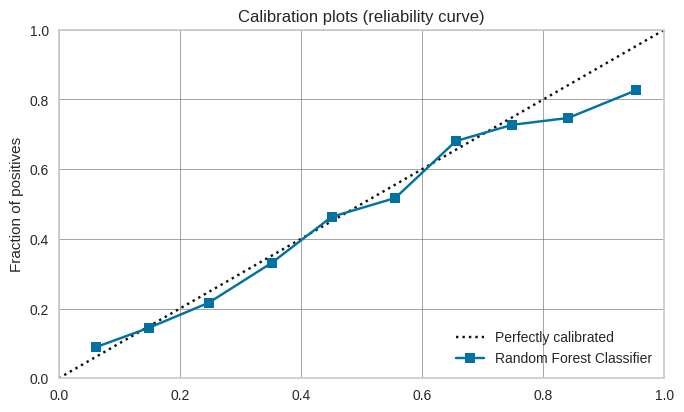

In [ ]:
plot_model(rf, plot='calibration')

In [ ]:
calibrated_rf = calibrate_model(rf)

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.8102,0.7648,0.3209,0.6292,0.4250,0.3254,0.3519
1,0.8340,0.7626,0.3954,0.7188,0.5102,0.4202,0.4474
2,0.8221,0.7758,0.3095,0.7152,0.4320,0.3456,0.3883
3,0.8264,0.7659,0.3725,0.6915,0.4842,0.3909,0.4180
4,0.8183,0.7683,0.3209,0.6788,0.4358,0.3437,0.3780
5,0.8239,0.7761,0.3496,0.6932,0.4648,0.3728,0.4042
6,0.8170,0.7725,0.3295,0.6647,0.4406,0.3458,0.3763
7,0.8271,0.7519,0.3410,0.7212,0.4630,0.3753,0.4128
8,0.8133,0.7475,0.3238,0.6457,0.4313,0.3340,0.3626
9,0.8207,0.7639,0.3391,0.6782,0.4521,0.3588,0.3897


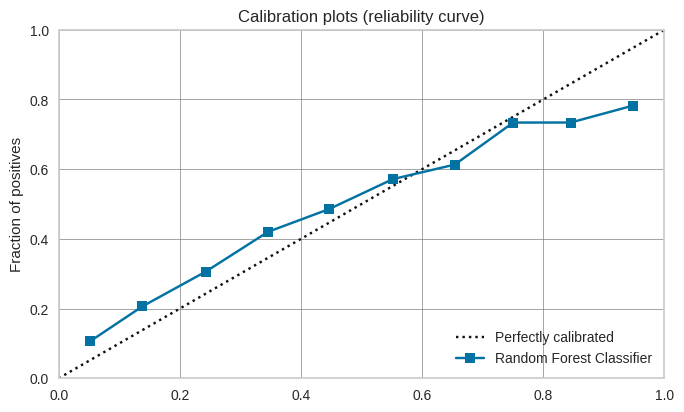

In [ ]:
plot_model(calibrated_rf, plot = 'calibration')

In [ ]:
calibrated_rf_isotonic = calibrate_model(rf, method = 'isotonic')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.8120,0.7636,0.3352,0.6324,0.4382,0.3379,0.3625
1,0.8346,0.7627,0.4011,0.7179,0.5147,0.4245,0.4506
2,0.8221,0.7753,0.3123,0.7124,0.4343,0.3473,0.3890
3,0.8227,0.7645,0.3868,0.6618,0.4882,0.3898,0.4104
4,0.8177,0.7673,0.3152,0.6790,0.4305,0.3389,0.3743
5,0.8258,0.7755,0.3754,0.6859,0.4852,0.3910,0.4167
6,0.8170,0.7719,0.3381,0.6592,0.4470,0.3507,0.3788
7,0.8246,0.7495,0.3496,0.6971,0.4656,0.3743,0.4062
8,0.8152,0.7479,0.3438,0.6452,0.4486,0.3497,0.3748
9,0.8207,0.7623,0.3621,0.6632,0.4684,0.3716,0.3962


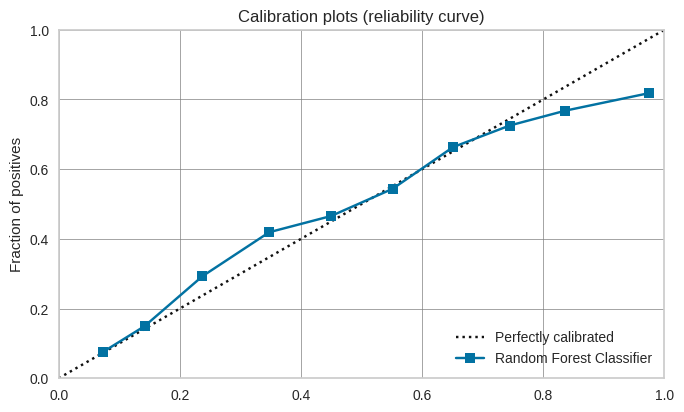

In [ ]:
plot_model(calibrated_rf_isotonic, plot='calibration')

### Интерпретация модели

Метод `interpret_model` внутри себя вызывает методы из библиотеки `shap`, поэтому нам её нужно установить.

In [ ]:
!pip install shap -q

In [ ]:
xgboost = create_model('xgboost')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.8133,0.7592,0.3438,0.6349,0.4461,0.3455,0.3691
1,0.8195,0.7649,0.3868,0.6459,0.4839,0.3828,0.4013
2,0.8239,0.7707,0.3668,0.6809,0.4767,0.3821,0.4086
3,0.8164,0.7696,0.3725,0.6373,0.4702,0.3682,0.3877
4,0.8133,0.7619,0.3438,0.6349,0.4461,0.3455,0.3691
5,0.8239,0.7618,0.4040,0.6589,0.5009,0.4014,0.4191
6,0.8120,0.7571,0.3467,0.6269,0.4465,0.3444,0.3663
7,0.8108,0.7426,0.3266,0.6298,0.4302,0.3301,0.3558
8,0.8102,0.7394,0.3496,0.6162,0.4461,0.3419,0.3619
9,0.8100,0.7400,0.3506,0.6131,0.4461,0.3415,0.3610


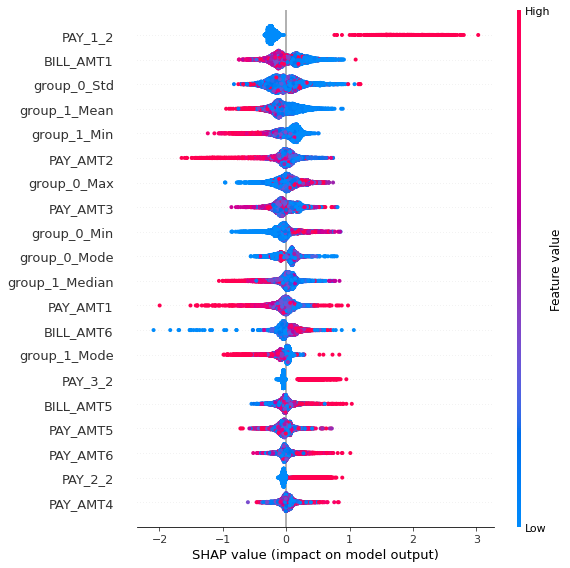

In [ ]:
interpret_model(xgboost)

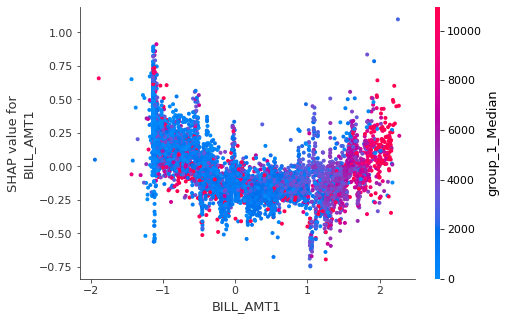

In [ ]:
interpret_model(xgboost, plot = 'correlation')

In [ ]:
interpret_model(xgboost, plot = 'reason', observation = 0) 

**Визуализация**

График AUC

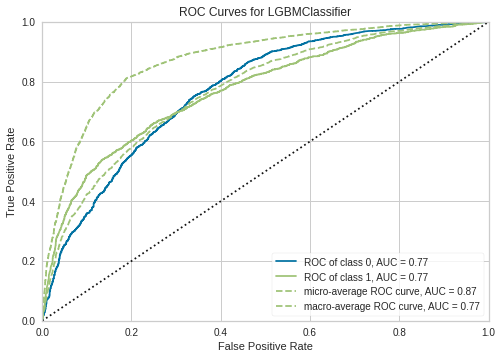

In [ ]:
plot_model(tuned_lightgbm, plot = 'auc')

Precision-Recall Curve

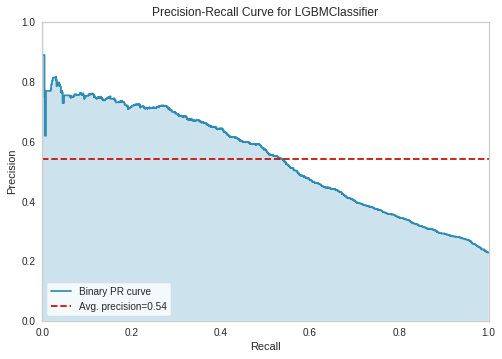

In [ ]:
plot_model(tuned_lightgbm, plot = 'pr')

Важность фич

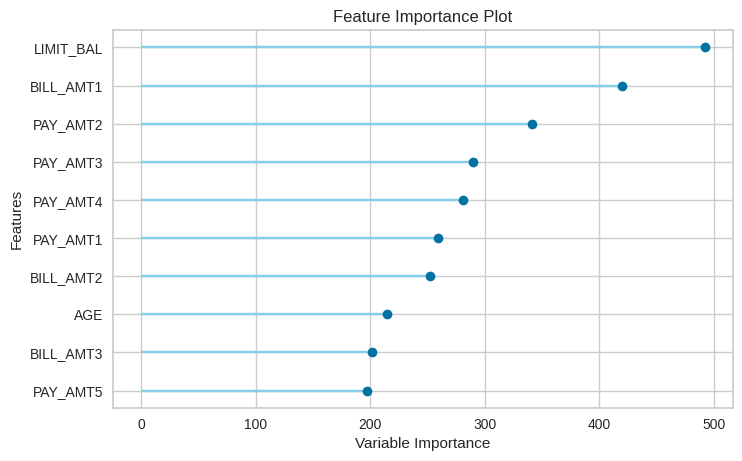

In [ ]:
plot_model(tuned_lightgbm, plot='feature')

Сonfusion matrix

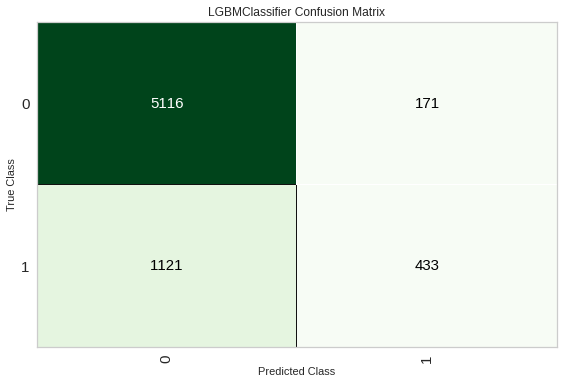

In [ ]:
plot_model(tuned_lightgbm, plot = 'confusion_matrix')


Либо можем вызвать метод `evaluate_model` и потом в меню выбрать необходимый график!

In [ ]:
evaluate_model(tuned_lightgbm)

interactive(children=(ToggleButtons(description='Plot Type:', icons=('',), options=(('Hyperparameters', 'param…

**Предсказать**

Когда мы вызывали метод `setup`, он автоматически разделил нам выборку на train и test. Если мы хотим проверить качество модели на отложенной выборки, нам достаточно вызвать метод `predict_model`.

In [ ]:
predict_model(tuned_lightgbm);

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,Light Gradient Boosting Machine,0.8111,0.7723,0.2786,0.7169,0.4013,0.3141,0.3637


**Финальная модель для продакшена**

После того, как мы прошли весь пайплайн, мы хотим получить модель, которую будем использовать в продакшене. Для этого нам нужно вызвать метод `finalize_model`, тогда модель будет для тренировки использовать все данные, не будет делить на train и test.

In [ ]:
final_lightgbm = finalize_model(tuned_lightgbm)

Посмотрим на гиперпараметры финальной модели.

In [ ]:
print(final_lightgbm)

LGBMClassifier(bagging_fraction=1.0, bagging_freq=6, boosting_type='gbdt',
               class_weight=None, colsample_bytree=1.0, feature_fraction=1.0,
               importance_type='split', learning_rate=0.015, max_depth=-1,
               min_child_samples=95, min_child_weight=0.001, min_split_gain=0.8,
               n_estimators=90, n_jobs=-1, num_leaves=50, objective=None,
               random_state=123, reg_alpha=0.15, reg_lambda=1e-07, silent=True,
               subsample=1.0, subsample_for_bin=200000, subsample_freq=0)


Узнаем метрику финальной модели

In [ ]:
predict_model(final_lightgbm);

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,Light Gradient Boosting Machine,0.813,0.819,0.2883,0.7214,0.412,0.3243,0.3727


Посмотрим предсказания на данных, которые модель никогда невидела. Мы эти данные `df_test` раздели самостоятельно в самом начале. Модель вернет наши данные, в которые добавит два столбца: `Label`, `score`. 

`Label`: предсказанный лейбл.

`score`: вероятность, мера уверенности модели в предсказании.

In [ ]:
unseen_predictions = predict_model(final_lightgbm, data = df_test)
unseen_predictions.head()

,LIMIT_BAL,SEX,EDUCATION,MARRIAGE,AGE,PAY_1,PAY_2,PAY_3,PAY_4,PAY_5,PAY_6,BILL_AMT1,BILL_AMT2,BILL_AMT3,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,default,Label,Score
0,100000,2,2,2,23,0,-1,-1,0,0,-1,11876.0,380.0,601.0,221.0,-159.0,567.0,380.0,601.0,0.0,581.0,1687.0,1542.0,0,0,0.8204
1,380000,1,2,2,32,-1,-1,-1,-1,-1,-1,22401.0,21540.0,15134.0,32018.0,11849.0,11873.0,21540.0,15138.0,24677.0,11851.0,11875.0,8251.0,0,0,0.9121
2,200000,2,2,1,32,-1,-1,-1,-1,2,-1,9076.0,5787.0,-684.0,5247.0,3848.0,3151.0,5818.0,15.0,9102.0,17.0,3165.0,1395.0,0,0,0.8008
3,200000,1,1,1,53,2,2,2,2,2,2,138180.0,140774.0,142460.0,144098.0,147124.0,149531.0,6300.0,5500.0,5500.0,5500.0,5000.0,5000.0,1,1,0.5884
4,240000,1,1,2,41,1,-1,-1,0,0,-1,95.0,2622.0,3301.0,3164.0,360.0,1737.0,2622.0,3301.0,0.0,360.0,1737.0,924.0,0,0,0.7758


Так как мы на выходе имеем предсказания модели, мы можем используя модуль `utils` измерить любую метрику, на данных которые модель никогда не видела.

Измери accuracy.

In [ ]:
from pycaret.utils import check_metric
check_metric(unseen_predictions['default'], unseen_predictions['Label'], metric = 'Accuracy')

0.8125

**Сохранение и загрузка модели**

In [ ]:
save_model(final_rf, 'Final RF Model 11Nov2020')

Transformation Pipeline and Model Succesfully Saved


(Pipeline(memory=None,
          steps=[('dtypes',
                  DataTypes_Auto_infer(categorical_features=[],
                                       display_types=True, features_todrop=[],
                                       id_columns=[],
                                       ml_usecase='classification',
                                       numerical_features=[], target='default',
                                       time_features=[])),
                 ('imputer',
                  Simple_Imputer(categorical_strategy='not_available',
                                 fill_value_categorical=None,
                                 fill_value_numerical=None,
                                 numeric_stra...
                                 colsample_bytree=1.0, feature_fraction=1.0,
                                 importance_type='split', learning_rate=0.015,
                                 max_depth=-1, min_child_samples=95,
                                 min_child_weight

In [ ]:
saved_final_rf = load_model('Final RF Model 11Nov2020')

Transformation Pipeline and Model Successfully Loaded


Документация: https://pycaret.readthedocs.io/

Подробные туториалы: https://github.com/pycaret/pycaret/tree/master/tutorials

Что нового в библиотеке 2.1: https://towardsdatascience.com/pycaret-2-1-is-here-whats-new-4aae6a7f636a

Что нового в библиотеке 2.2: https://towardsdatascience.com/pycaret-2-2-is-here-whats-new-ad7612ca63b